In [1]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from keras.models import Sequential
from keras.optimizers import Adam
from keras.callbacks import ModelCheckpoint
from keras.layers import Lambda, Conv2D, MaxPooling2D, Dropout, Dense, Flatten
from utils import INPUT_SHAPE, batch_generator
import argparse
import os

np.random.seed(0)

Using TensorFlow backend.


In [2]:
import matplotlib.pyplot as plt
import numpy as np
import cv2
import os
import math
%matplotlib inline

# download data for cloud

In [3]:
from download_file import *
url = "https://d17h27t6h515a5.cloudfront.net/topher/2016/December/584f6edd_data/data.zip"
download_dir = '..//..//datasets_collection//behavior_cloning_track_02'
maybe_download_and_extract(url, download_dir)    

Data has apparently already been downloaded and unpacked.


# Utility

In [3]:
def display_imgs_uint8(imgs, img_num_per_row, img_size, fig_size, title):
    """
    A function to show imageS
    
    parameter:
    
    -- imgs: list
           List of images
    -- img_num_per_row: int
           THE number of images per row
    -- img_size: tuple of two ints
           Image size 
    -- fig_size: tuple of two ints
           Figure size
    """

    col_num = math.ceil(len(imgs)/img_num_per_row)
    RGB_img = np.zeros((img_size[0] * col_num, img_size[1] * img_num_per_row, 3), dtype=np.uint8)

    for i, img in enumerate(imgs):            
        RGB_img[img_size[0] * (i//img_num_per_row):img_size[0] * ((i//img_num_per_row) + 1)
                ,img_size[1] * (i%img_num_per_row):img_size[1] * ((i%img_num_per_row) + 1),:] = img

    fig, ax = plt.subplots(figsize=fig_size)
    ax.set_title(title)
    ax.imshow(RGB_img, aspect='auto')
    plt.tight_layout()
    return RGB_img

In [4]:
def load_data(data_dir, test_size):
    """
    Load training data and split it into training and validation set
    """
    data_df = pd.read_csv(os.path.join(data_dir, 'driving_log.csv'))

    X = data_df[['center', 'left', 'right']].values
    y = data_df['steering'].values

    X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=test_size, random_state=0)

    return X_train, X_valid, y_train, y_valid

In [5]:
def build_model(keep_prob):
    """
    Modified NVIDIA model
    Ref: https://devblogs.nvidia.com/deep-learning-self-driving-cars/
    """
    model = Sequential()
    model.add(Lambda(lambda x: x/127.5-1.0, input_shape=INPUT_SHAPE))
    model.add(Conv2D(24, 5, 5, activation='elu', subsample=(2, 2)))
    model.add(Conv2D(36, 5, 5, activation='elu', subsample=(2, 2)))
    model.add(Conv2D(48, 5, 5, activation='elu', subsample=(2, 2)))
    model.add(Conv2D(64, 3, 3, activation='elu'))
    model.add(Conv2D(64, 3, 3, activation='elu'))
    model.add(Dropout(keep_prob))
    model.add(Flatten())
    model.add(Dense(100, activation='elu'))
    model.add(Dense(50, activation='elu'))
    model.add(Dense(10, activation='elu'))
    model.add(Dense(1))
    model.summary()

    return model

In [6]:
def train_model(model, parameter, X_train, X_valid, y_train, y_valid):
    """
    Train the model
    """
    checkpoint = ModelCheckpoint('model-{epoch:03d}.h5',
                                 monitor='val_loss',
                                 verbose=0,
                                 save_best_only=parameter["save_best_only"],
                                 mode='auto')

    model.compile(loss='mean_squared_error', optimizer=Adam(lr=parameter["learning_rate"]))

    model.fit_generator(batch_generator(parameter["data_dir"], X_train, y_train, parameter["batch_size"], True),
                        parameter["samples_per_epoch"],
                        parameter["nb_epoch"],
                        max_q_size=1,
                        validation_data=batch_generator(parameter["data_dir"], X_valid, y_valid, parameter["batch_size"], False),
                        nb_val_samples=len(X_valid),
                        callbacks=[checkpoint],
                        verbose=1)

In [8]:
keep_prob = 0.5
test_size = 0.2
nb_epoch = 10
samples_per_epoch = 20000
batch_size = 64
save_best_only = True
learning_rate = 1.0e-4

print('-' * 30)
print('load_data')
data_path = "..\\..\\datasets_collection\\behavior_cloning_track_02"
data = load_data(data_dir = data_path, test_size = 0.2)
print('-' * 30)
print('build_model')
model = build_model(keep_prob)
print('-' * 30)
print('train_model')
parameters = {
            "data_dir": data_path
            , "nb_epoch" : 1
            , "samples_per_epoch" : 20000
            , "batch_size" : 64
            , "save_best_only" : True
            , "learning_rate" : 1.0e-4} 

------------------------------
load_data
------------------------------
build_model
____________________________________________________________________________________________________
Layer (type)                     Output Shape          Param #     Connected to                     
lambda_1 (Lambda)                (None, 66, 200, 3)    0           lambda_input_1[0][0]             
____________________________________________________________________________________________________
convolution2d_1 (Convolution2D)  (None, 31, 98, 24)    1824        lambda_1[0][0]                   
____________________________________________________________________________________________________
convolution2d_2 (Convolution2D)  (None, 14, 47, 36)    21636       convolution2d_1[0][0]            
____________________________________________________________________________________________________
convolution2d_3 (Convolution2D)  (None, 5, 22, 48)     43248       convolution2d_2[0][0]            
_______

In [9]:
X_train, X_valid, y_train, y_valid = data

In [10]:

# train_model(model, parameters, *data)
# print('end')
    
    


In [12]:
import glob
import numpy as np
import matplotlib.image as mpimg

In [13]:
images = glob.glob('..//..//Datasets_collection//behavior_cloning_track_02//IMG//*')
print ("total image number: " + str(len(images)))

total image number: 5304


In [14]:
views = [] 
for i in np.random.choice(len(images), 10):
    views.append(mpimg.imread(images[i]))

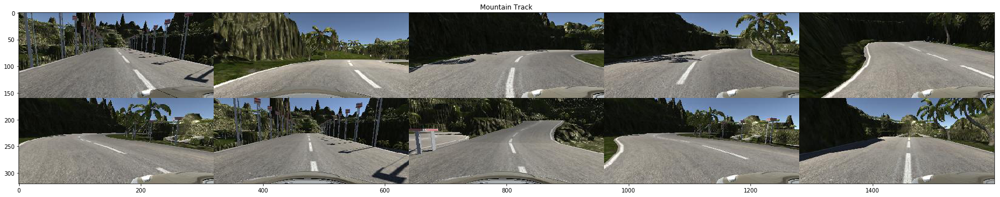

In [15]:
RGB_img = display_imgs_uint8(views, 5, (160,320), (25,5), "Mountain Track")

# Preprocessing

## Cropping unused region

In [16]:
Crop_imgs = []
for i in views:
    Crop_imgs.append(i[60:-25, :, :])

In [17]:
Crop_imgs[0].shape

(75, 320, 3)

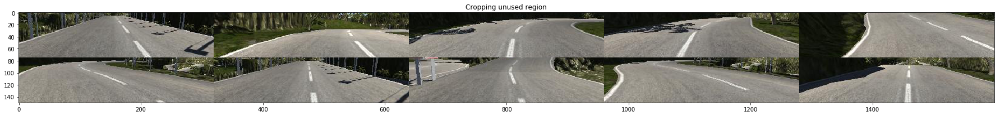

In [18]:
Cropped_imgs = display_imgs_uint8(Crop_imgs, 5, (75,320), (25,3), "Cropping unused region")

## Resizing

In [19]:
IMAGE_HEIGHT, IMAGE_WIDTH, IMAGE_CHANNELS = 15, 64, 3
Resize_img = []
for i in Crop_imgs:
    Resize_img.append(cv2.resize(i, (IMAGE_WIDTH, IMAGE_HEIGHT), cv2.INTER_AREA))

In [20]:
Resize_img[0].shape

(15, 64, 3)

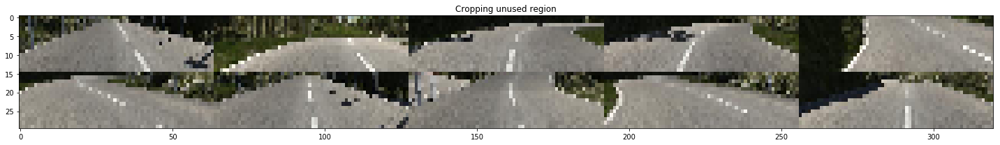

In [21]:
Resized_img = display_imgs_uint8(Resize_img, 5, (IMAGE_HEIGHT,IMAGE_WIDTH), (20,3), "Cropping unused region")

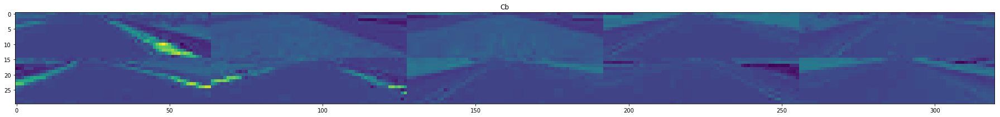

In [82]:
fig, ax = plt.subplots(figsize=(25,5))
ax.set_title("Cb")
ax.imshow(test[:,:,1])
plt.tight_layout()

In [23]:
def convert_color(img, conv='YCrCb'):
    if conv == 'YCrCb':
        return cv2.cvtColor(img, cv2.COLOR_RGB2YCrCb)
    if conv == 'HSV':
        return cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    if conv == 'LUV':
        return cv2.cvtColor(img, cv2.COLOR_RGB2LUV)
    if conv == 'HLS':
        return cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    if conv == 'LAB':
        return cv2.cvtColor(img, cv2.COLOR_RGB2LAB)
    if conv == 'YUV':
        return cv2.cvtColor(img, cv2.COLOR_RGB2YUV)

In [24]:
YCrCb_views = convert_color(RGB_img, 'YCrCb')
HSV_views = convert_color(RGB_img, 'HSV')
LUV_views = convert_color(RGB_img, 'LUV')
HLS_views = convert_color(RGB_img, 'HLS')
LAB_views = convert_color(RGB_img, 'LAB')
YUV_views = convert_color(RGB_img, 'YUV')

## RGB

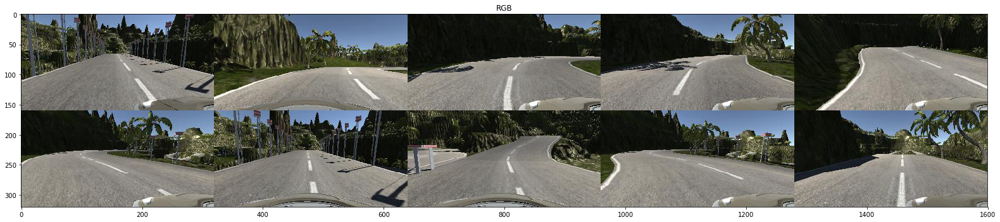

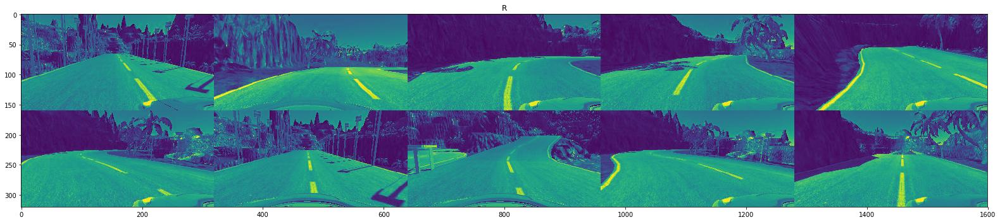

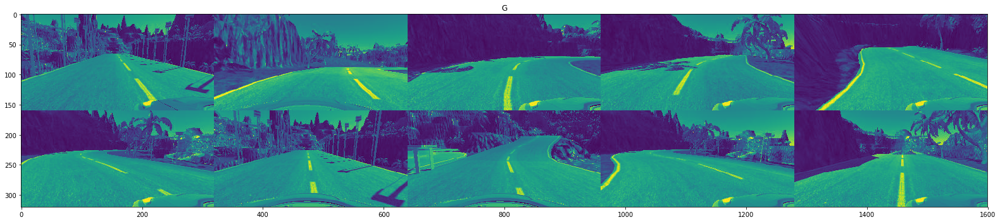

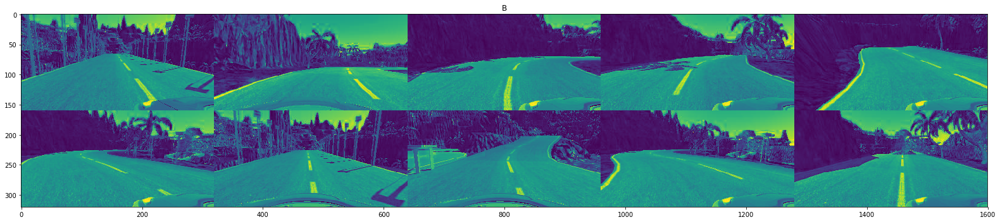

In [32]:
fig, ax = plt.subplots(figsize=(25,5))
ax.set_title("RGB")
ax.imshow(RGB_img)
plt.tight_layout()

fig, ax = plt.subplots(figsize=(25,5))
ax.set_title("R")
ax.imshow(RGB_img[:,:,0])
plt.tight_layout()

fig, ax = plt.subplots(figsize=(25,5))
ax.set_title("G")
ax.imshow(RGB_img[:,:,1])
plt.tight_layout()

fig, ax = plt.subplots(figsize=(25,5))
ax.set_title("B")
ax.imshow(RGB_img[:,:,2])
plt.tight_layout()

# Color space 

## YCrCb

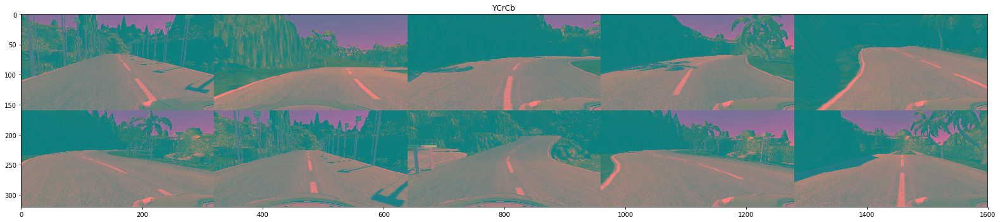

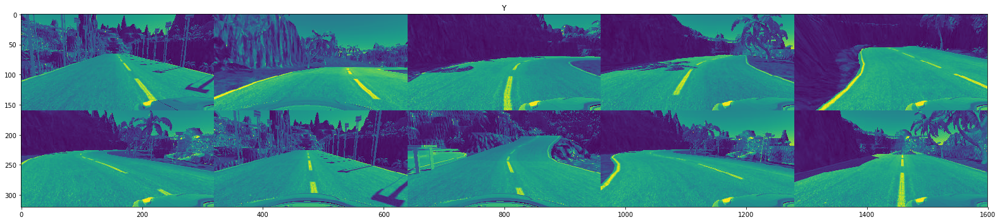

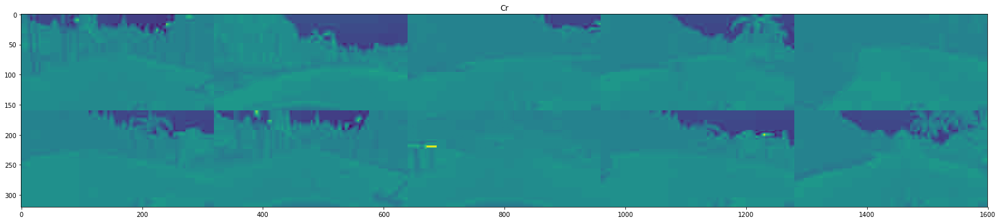

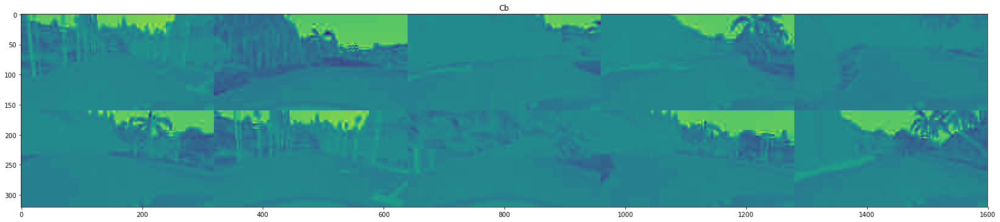

In [25]:
fig, ax = plt.subplots(figsize=(25,5))
ax.set_title("YCrCb")
ax.imshow(YCrCb_views)
plt.tight_layout()

fig, ax = plt.subplots(figsize=(25,5))
ax.set_title("Y")
ax.imshow(YCrCb_views[:,:,0])
plt.tight_layout()

fig, ax = plt.subplots(figsize=(25,5))
ax.set_title("Cr")
ax.imshow(YCrCb_views[:,:,1])
plt.tight_layout()

fig, ax = plt.subplots(figsize=(25,5))
ax.set_title("Cb")
ax.imshow(YCrCb_views[:,:,2])
plt.tight_layout()

## HSV

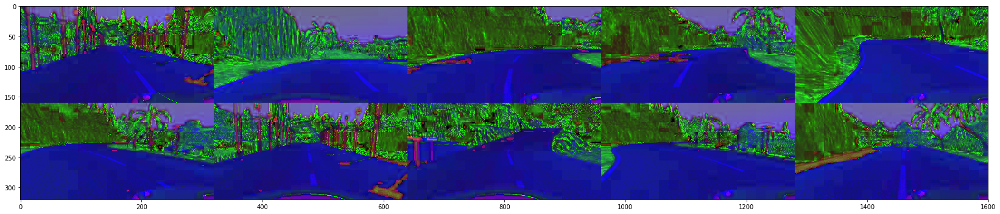

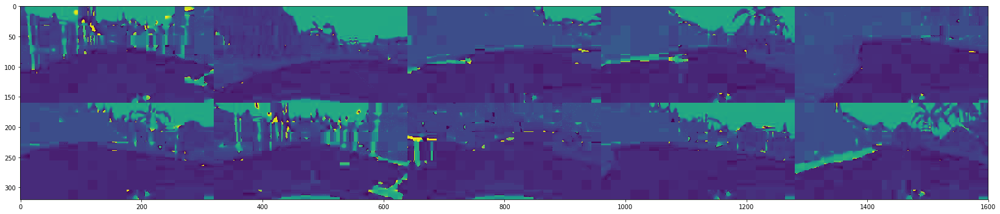

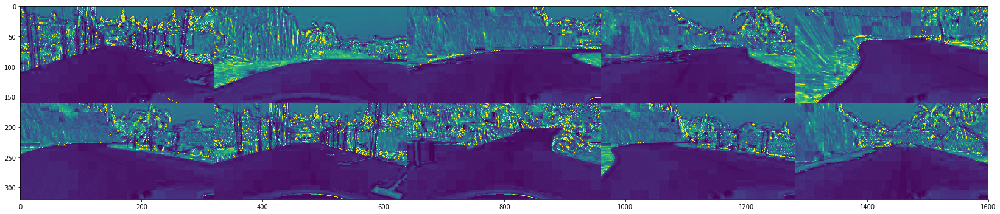

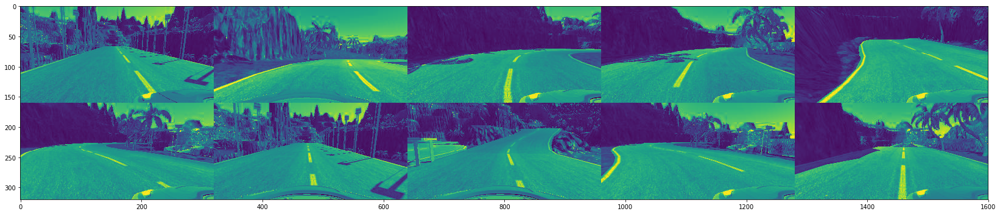

In [26]:
## HSV
fig, ax = plt.subplots(figsize=(25,5))
ax.imshow(HSV_views)
plt.tight_layout()
### H
fig, ax = plt.subplots(figsize=(25,5))
ax.imshow(HSV_views[:,:,0])
plt.tight_layout()
### S
fig, ax = plt.subplots(figsize=(25,5))
ax.imshow(HSV_views[:,:,1])
plt.tight_layout()
### V
fig, ax = plt.subplots(figsize=(25,5))
ax.imshow(HSV_views[:,:,2])
plt.tight_layout()

## LUV

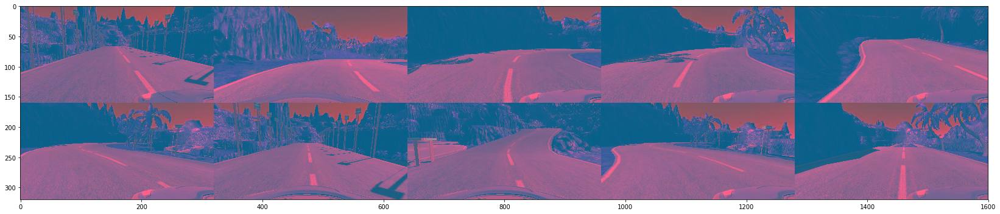

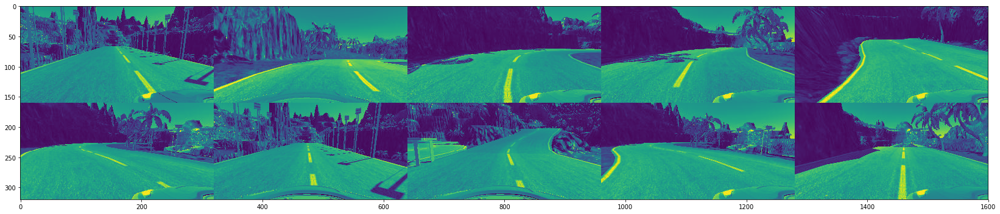

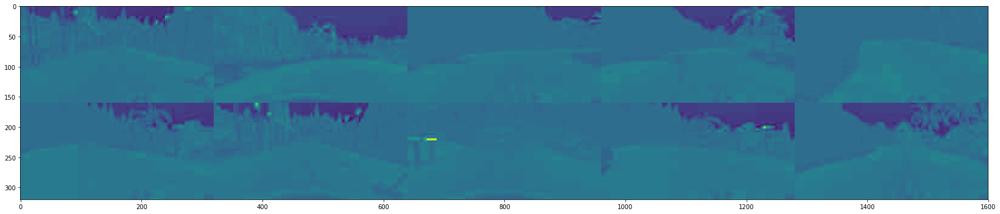

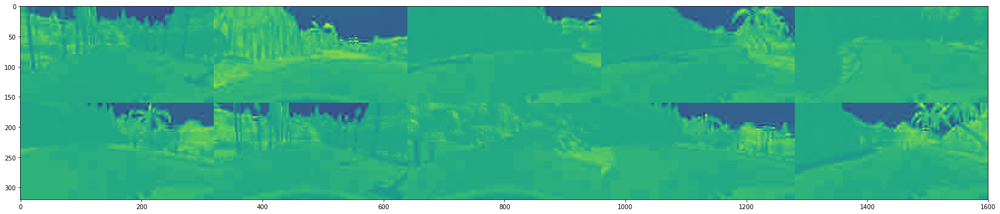

In [27]:
## LUV
fig, ax = plt.subplots(figsize=(25,5))
ax.imshow(LUV_views)
plt.tight_layout()
### L
fig, ax = plt.subplots(figsize=(25,5))
ax.imshow(LUV_views[:,:,0])
plt.tight_layout()
### U
fig, ax = plt.subplots(figsize=(25,5))
ax.imshow(LUV_views[:,:,1])
plt.tight_layout()
### V
fig, ax = plt.subplots(figsize=(25,5))
ax.imshow(LUV_views[:,:,2])
plt.tight_layout()

## HLS

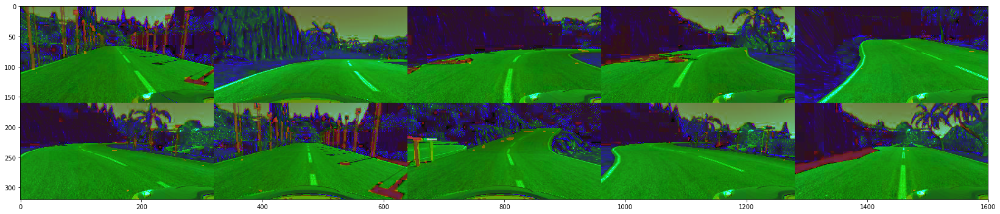

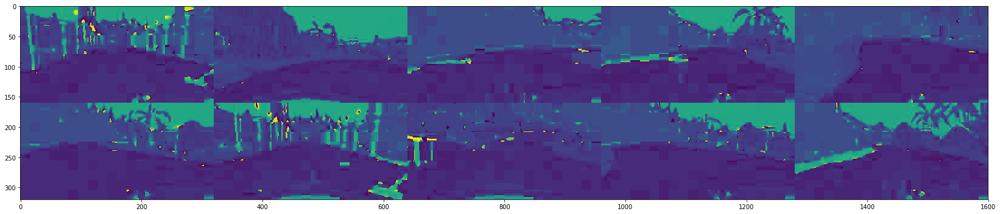

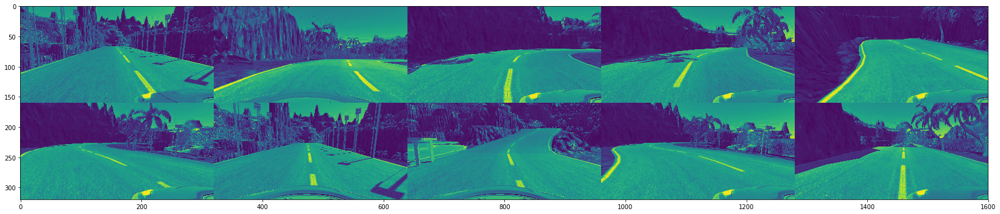

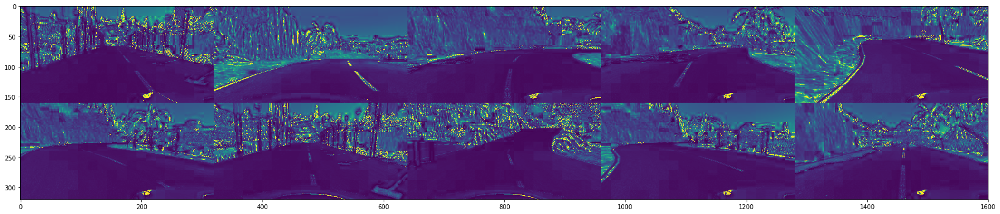

In [28]:
## HLS
fig, ax = plt.subplots(figsize=(25,5))
ax.imshow(HLS_views)
plt.tight_layout()
### H
fig, ax = plt.subplots(figsize=(25,5))
ax.imshow(HLS_views[:,:,0])
plt.tight_layout()
### L
fig, ax = plt.subplots(figsize=(25,5))
ax.imshow(HLS_views[:,:,1])
plt.tight_layout()
### S
fig, ax = plt.subplots(figsize=(25,5))
ax.imshow(HLS_views[:,:,2])
plt.tight_layout()

## LAB

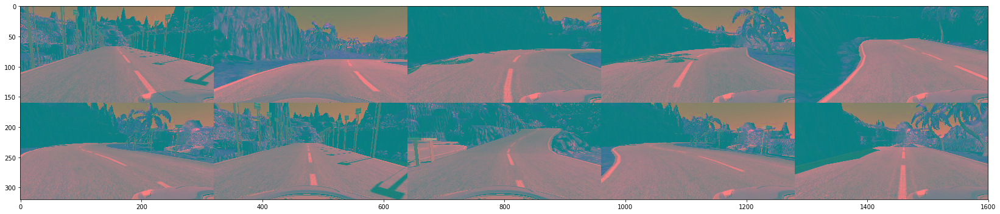

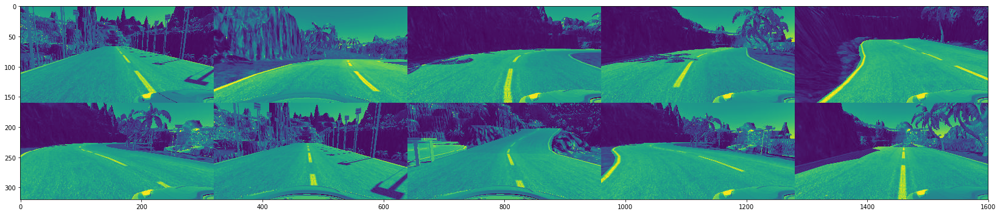

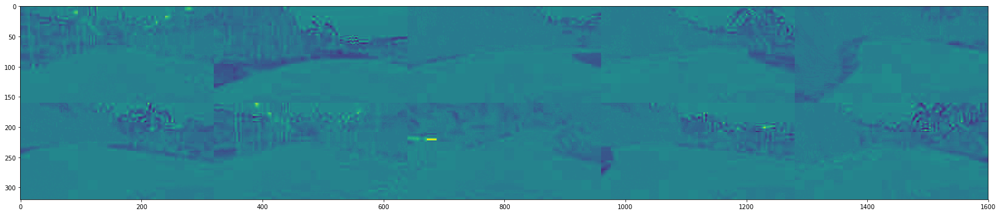

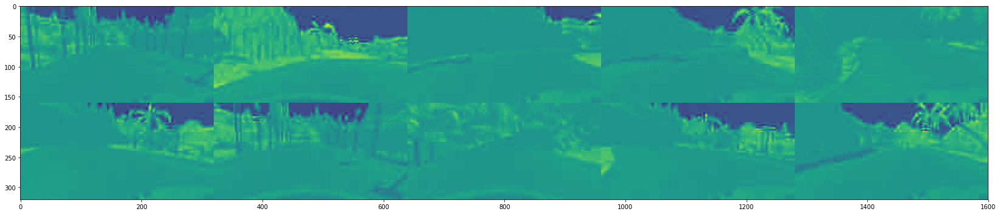

In [29]:
## LAB
fig, ax = plt.subplots(figsize=(25,5))
ax.imshow(LAB_views)
plt.tight_layout()
### L
fig, ax = plt.subplots(figsize=(25,5))
ax.imshow(LAB_views[:,:,0])
plt.tight_layout()
### A
fig, ax = plt.subplots(figsize=(25,5))
ax.imshow(LAB_views[:,:,1])
plt.tight_layout()
### B
fig, ax = plt.subplots(figsize=(25,5))
ax.imshow(LAB_views[:,:,2])
plt.tight_layout()

## YUV

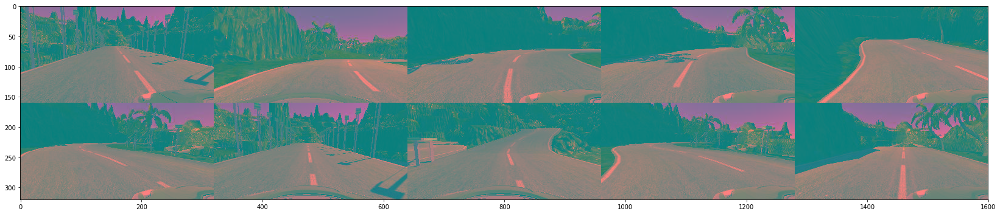

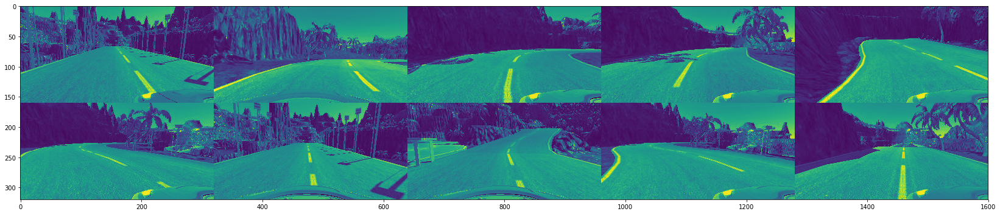

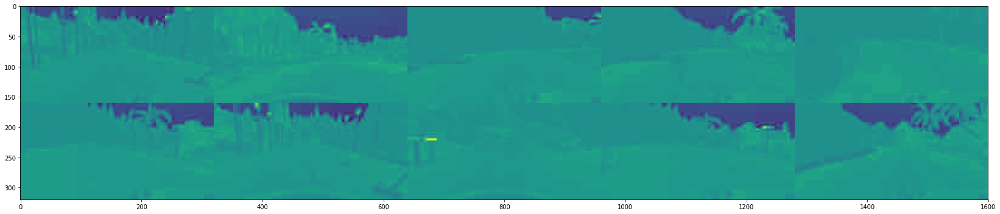

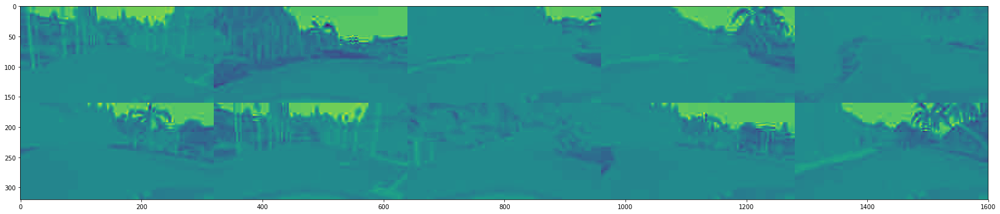

In [30]:
## YUV
fig, ax = plt.subplots(figsize=(25,5))
ax.imshow(YUV_views)
plt.tight_layout()
### Y
fig, ax = plt.subplots(figsize=(25,5))
ax.imshow(YUV_views[:,:,0])
plt.tight_layout()
### U
fig, ax = plt.subplots(figsize=(25,5))
ax.imshow(YUV_views[:,:,1])
plt.tight_layout()
### V
fig, ax = plt.subplots(figsize=(25,5))
ax.imshow(YUV_views[:,:,2])
plt.tight_layout()

In [34]:
YUV_views.shape

(320, 1600, 3)

In [ ]:
RGB_img
YCrCb_views[:,:,0]
HSV_views [:,:,1], [:,:,2]
LUV_views[:,:,0]
HLS_views [:,:,1], [:,:,2]
LAB_views [:,:,0]
YUV_views[:,:,0]

In [36]:
RGB_img[:,:,2].shape

(320, 1600)

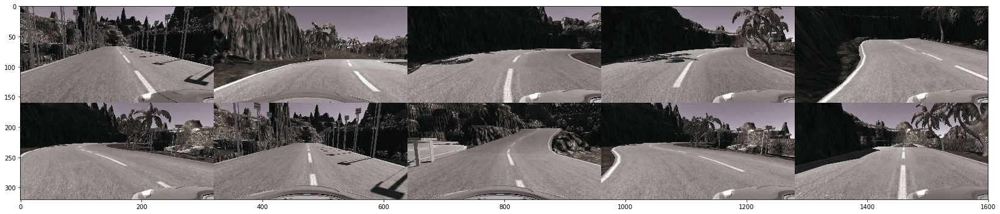

In [41]:
combined_color_img = np.dstack((LAB_views [:,:,0], YCrCb_views[:,:,0], YUV_views[:,:,0]))

fig, ax = plt.subplots(figsize=(25,5))
ax.imshow(combined_color_img)
plt.tight_layout()